In [1]:
import os
import numpy as np
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
property = gpd.read_file('data/cycle/Market_value_usable_hedonic_data.csv', engine='pyogrio')
canopy = gpd.read_file('data/canopy.gdb', engine='pyogrio')
ta = gpd.read_file('data/chc-boundaries/territorial-authority-2021-generalised.gpkg', engine='pyogrio')
sa2 = gpd.read_file('data/chc-boundaries/sa2/statistical-area-2-2023-generalised.shp')

/Users/rujalshrestha/Projects/chc-property-prices/venv/lib/python3.13/site-packages/pyogrio/raw.py:198: RuntimeWarning: organizePolygons() received a polygon with more than 100 parts. The processing may be really slow.  You can skip the processing by setting METHOD=SKIP, or only make it analyze counter-clock wise parts by setting METHOD=ONLY_CCW if you can assume that the outline of holes is counter-clock wise defined
  return ogr_read(


In [3]:
ta_chc = ta[ta['TA2021_V1_00_NAME_ASCII'].str.lower().str.contains('christchurch')]
ta_chc.head()

,TA2021_V1_00,TA2021_V1_00_NAME,TA2021_V1_00_NAME_ASCII,LAND_AREA_SQ_KM,AREA_SQ_KM,Shape_Length,geometry
51,060,Christchurch City,Christchurch City,1415.437559,1608.602046,323655.640667,"MULTIPOLYGON (((1575709.746 5195732.032, 15757..."


(np.float64(1545600.8572850004),
 np.float64(1613574.6580149997),
 np.float64(5136205.895164999),
 np.float64(5198681.742335))

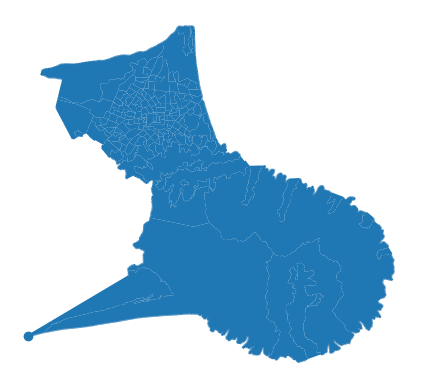

In [4]:
sa2_chc = gpd.clip(sa2, ta_chc)
sa2_chc.plot()
plt.axis('off')

In [5]:
pd.set_option('display.max_columns', None)

In [6]:
property_old = property[property['YearSold'].isin(['2017', '2018', '2019'])]

In [7]:
property_old.columns

Index(['field_1', 'Unnamed: 0.2', 'Unnamed: 0.1', 'Unnamed: 0',
       'FullStreetNumber', 'RoadName', 'suburb_loc', 'YearSold', 'AgeAtSale',
       'GrossSalePrice', 'CapitalValue', 'LandValue', 'ImprovementsValue',
       'PriceValueRelationship', 'LandArea', 'TotalFloorArea', 'gd2000co',
       'gd2000_yco', 'cycleways_DIST', 'cycle_DENS', 'on_DIST', 'on_DENS',
       'Green_DIST', 'water_DIST', 'bus_DIST', 'Census_Pop', 'RnkIMDNoEm',
       'RnkIMDNoIn', 'RnkIMDNoCr', 'RnkIMDNoHo', 'RnkIMDNoHe', 'RnkIMDNoEd',
       'RnkIMDNoAc', 'DECILE_high', 'DECILE_prim', 'Median_Income', 'CBD_DIST',
       'Ratio', 'z_score'],
      dtype='object')

In [8]:
property_gdf = gpd.GeoDataFrame(
  property_old,
  geometry=gpd.points_from_xy(property_old['gd2000co'], property_old['gd2000_yco']),
  crs=4326
).to_crs(2193)

In [9]:
property_gdf.explore()